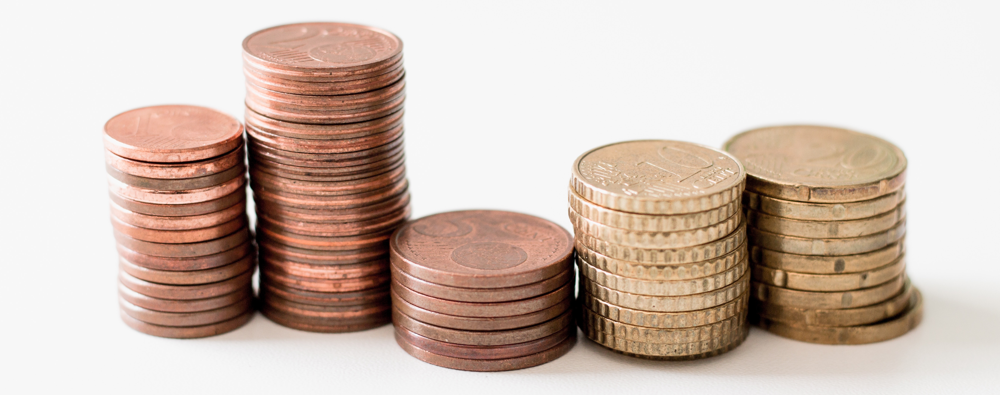

# LOAN_FARUD_DETECTION

In [2]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [3]:
df=pd.read_csv('loan_fraud_detection.csv')
df

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Loan_ID            614 non-null    object 
 1   Gender             601 non-null    object 
 2   Married            611 non-null    object 
 3   Dependents         599 non-null    object 
 4   Education          614 non-null    object 
 5   Self_Employed      582 non-null    object 
 6   ApplicantIncome    614 non-null    int64  
 7   CoapplicantIncome  614 non-null    float64
 8   LoanAmount         592 non-null    float64
 9   Loan_Amount_Term   600 non-null    float64
 10  Credit_History     564 non-null    float64
 11  Property_Area      614 non-null    object 
 12  Loan_Status        614 non-null    object 
dtypes: float64(4), int64(1), object(8)
memory usage: 62.5+ KB


In [5]:
df.describe()

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History
count,614.000000,614.000000,592.000000,600.00000,564.000000
mean,5403.459283,1621.245798,146.412162,342.00000,0.842199
std,6109.041673,2926.248369,85.587325,65.12041,0.364878
min,150.000000,0.000000,9.000000,12.00000,0.000000
25%,2877.500000,0.000000,100.000000,360.00000,1.000000
50%,3812.500000,1188.500000,128.000000,360.00000,1.000000
75%,5795.000000,2297.250000,168.000000,360.00000,1.000000
max,81000.000000,41667.000000,700.000000,480.00000,1.000000


In [6]:
#The mean and median are higher differnce in coapplicant income and loan amount

In [7]:
df.dtypes

Loan_ID               object
Gender                object
Married               object
Dependents            object
Education             object
Self_Employed         object
ApplicantIncome        int64
CoapplicantIncome    float64
LoanAmount           float64
Loan_Amount_Term     float64
Credit_History       float64
Property_Area         object
Loan_Status           object
dtype: object

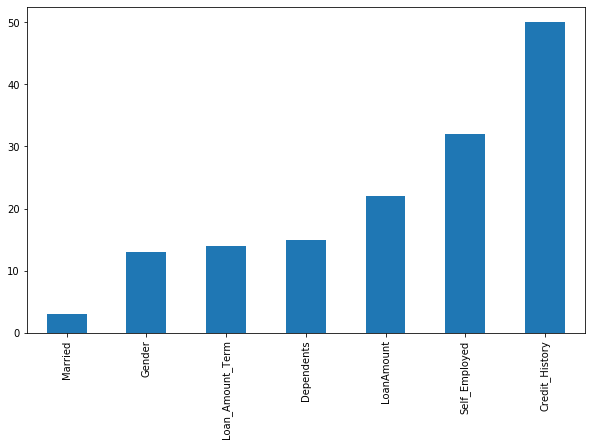

In [8]:
# To see the missing values 
missing=df.isnull().sum()
missing=missing[missing>0]
missing.sort_values(inplace=True)
plt.figure(figsize=(10,6))
missing.plot.bar()

In [9]:
df

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


In [10]:
#drop the missing values
df=df.dropna()

In [11]:
#check the missing values 
df.isnull().sum()

Loan_ID              0
Gender               0
Married              0
Dependents           0
Education            0
Self_Employed        0
ApplicantIncome      0
CoapplicantIncome    0
LoanAmount           0
Loan_Amount_Term     0
Credit_History       0
Property_Area        0
Loan_Status          0
dtype: int64

In [12]:
#as we know the loan_id is not useful for our dataset
df=df.drop(columns=['Loan_ID'])
df

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
1,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
5,Male,Yes,2,Graduate,Yes,5417,4196.0,267.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...
609,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


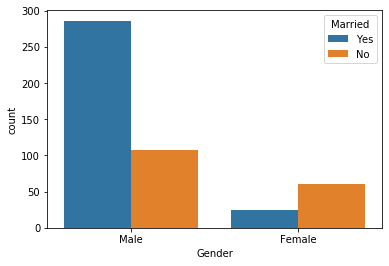

In [13]:
sns.countplot(x='Gender',hue='Married',data=df)

In [14]:
#Married males are higher than females

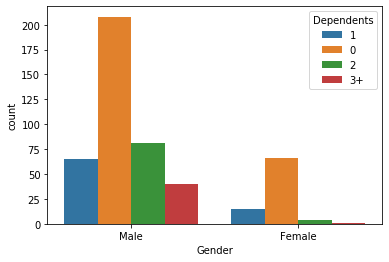

In [15]:
sns.countplot(x='Gender',hue='Dependents',data=df)

In [16]:
#Dependants are higher to male compare female

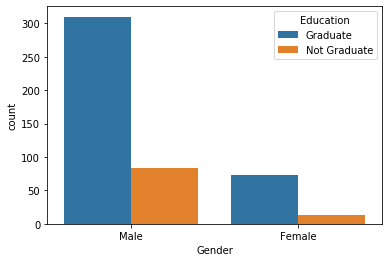

In [17]:
sns.countplot(x='Gender',hue='Education',data=df)

In [18]:
#Male graduates are higher compare to female

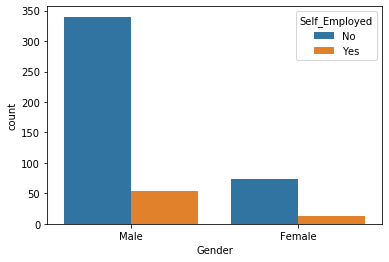

In [19]:
sns.countplot(x='Gender',hue='Self_Employed',data=df)

In [20]:
#self employed of males are higher

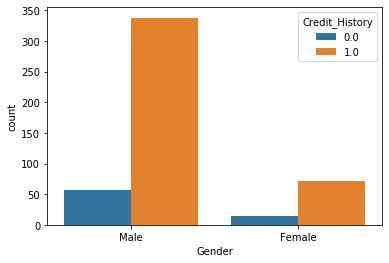

In [21]:
sns.countplot(x='Gender',hue='Credit_History',data=df)

In [22]:
#credit history 1.0,0.0 is higher in female

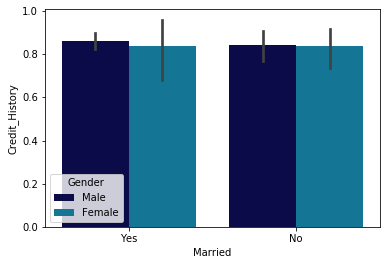

In [23]:
sns.barplot(y='Credit_History',x='Married',hue='Gender',data=df,palette='ocean')

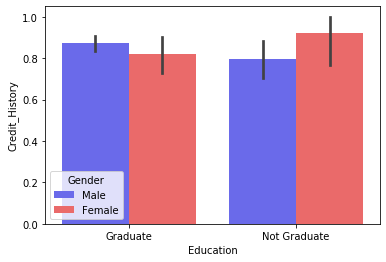

In [24]:
sns.barplot(x='Education',y='Credit_History',hue='Gender',data=df,palette='seismic')

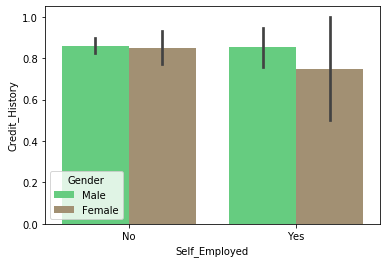

In [25]:
sns.barplot(x='Self_Employed',y='Credit_History',hue='Gender',data=df,palette='terrain')

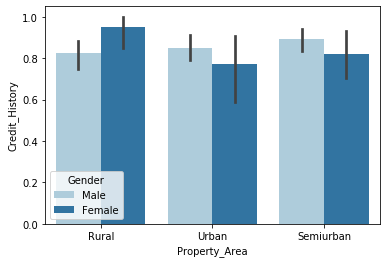

In [26]:
sns.barplot(x='Property_Area',y='Credit_History',hue='Gender',data=df,palette='Paired')

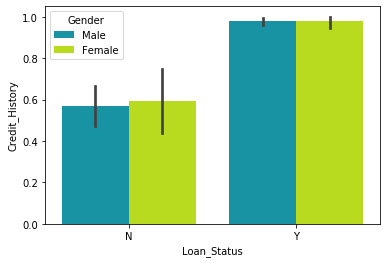

In [27]:
sns.barplot(x='Loan_Status',y='Credit_History',hue='Gender',data=df,palette='nipy_spectral')

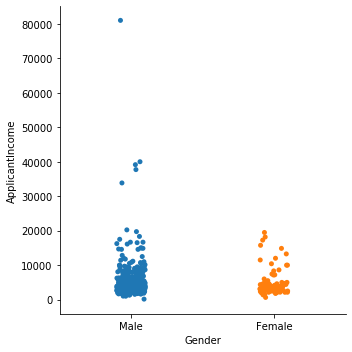

In [28]:
sns.catplot(x='Gender',y='ApplicantIncome',data=df)

In [29]:
#Applicant income is higher in male compare to female

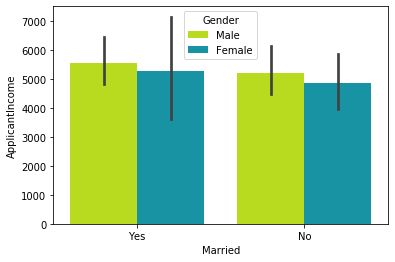

In [30]:
sns.barplot(x='Married',y='ApplicantIncome',data=df,hue='Gender',palette='nipy_spectral_r')

In [31]:
##applicant income is higher for married compare to single

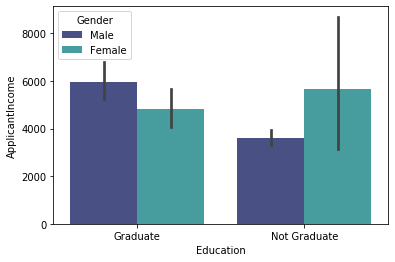

In [32]:
sns.barplot(x='Education',y='ApplicantIncome',hue='Gender',data=df,palette='mako')

In [33]:
#Applicant income is higher for gradutes compare to non graduates

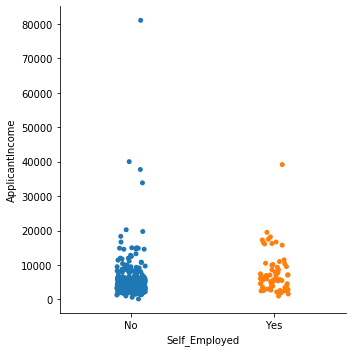

In [34]:
sns.catplot(x='Self_Employed',y='ApplicantIncome',data=df)

In [35]:
#Applicant income for self employed persons are lower 

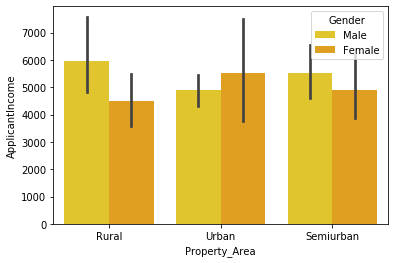

In [36]:
sns.barplot(x='Property_Area',y='ApplicantIncome',hue='Gender',data=df,palette='Wistia')

In [37]:
#Applicant income is higher in number of persons at area is in rural area followed by semiurban

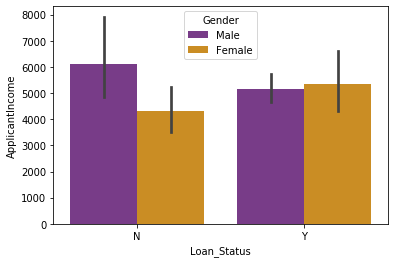

In [38]:
sns.barplot(x='Loan_Status',y='ApplicantIncome',hue='Gender',data=df,palette='CMRmap')

In [39]:
#based on applicant income loan staus no chances are higher

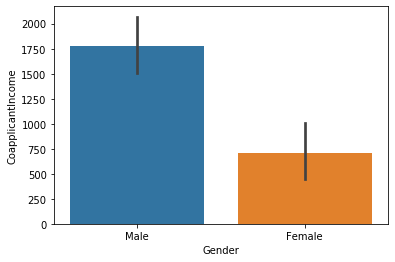

In [40]:
sns.barplot(x='Gender',y='CoapplicantIncome',data=df)

In [41]:
#Coapplicant income is higher for males

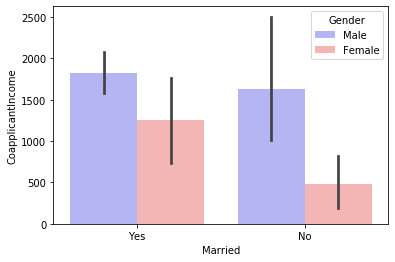

In [42]:
sns.barplot(x='Married',y='CoapplicantIncome',data=df,hue='Gender',palette='bwr')

In [43]:
#Coapplicant income is higher in married of males

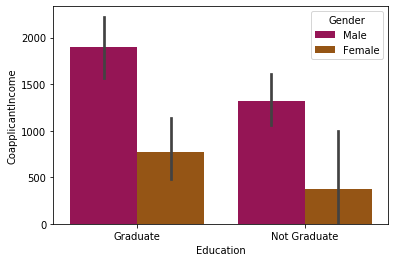

In [44]:
sns.barplot(x='Education',y='CoapplicantIncome',hue='Gender',data=df,palette='brg')

In [45]:
#coapplicant income for gradutes is higher

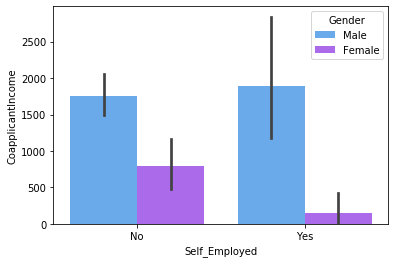

In [46]:
sns.barplot(x='Self_Employed',y='CoapplicantIncome',data=df,hue='Gender',palette='cool')

In [47]:
#coapplicant income is higher in self employed

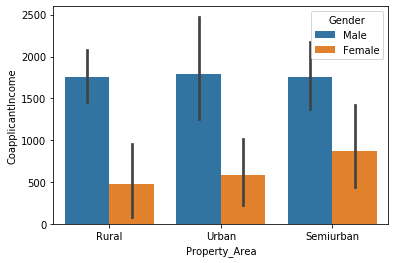

In [48]:
sns.barplot(x='Property_Area',y='CoapplicantIncome',hue='Gender',data=df)

In [49]:
#coapplicant income is higher in area of urban regions compared to both

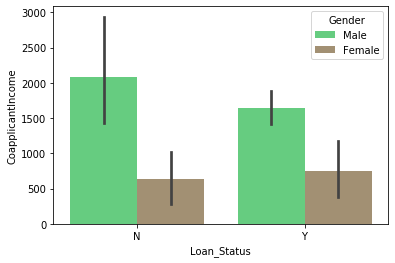

In [50]:
sns.barplot(x='Loan_Status',y='CoapplicantIncome',data=df,hue='Gender',palette='terrain')

In [51]:
#loan status for coapplicant income is no chances are higher

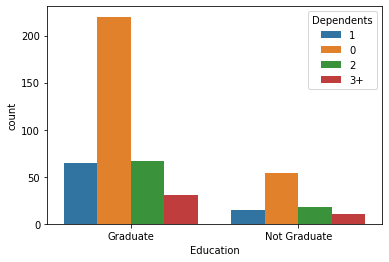

In [52]:
sns.countplot(x='Education',hue='Dependents',data=df)

In [53]:
#number of dependents based oneducation for gradutes are higher

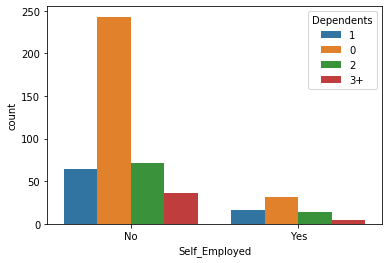

In [54]:
sns.countplot(x='Self_Employed',hue='Dependents',data=df)

In [55]:
# number of non self employed persons has higher dependents

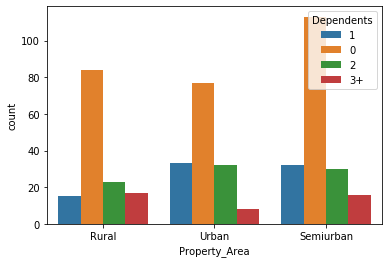

In [56]:
sns.countplot(x='Property_Area',hue='Dependents',data=df)

In [57]:
#number of dependents in 3 property regions urban area has higher dependants whereas rural area dependents are low

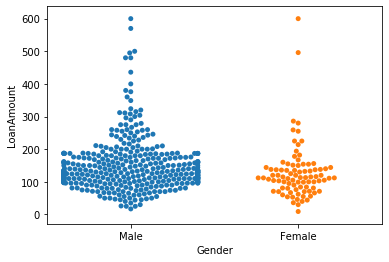

In [58]:
sns.swarmplot(y='LoanAmount',x='Gender',data=df)

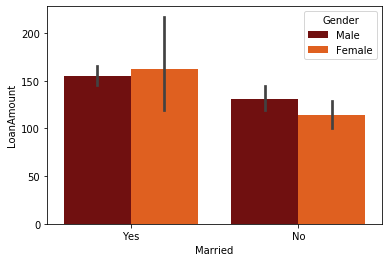

In [59]:
sns.barplot(y='LoanAmount',x='Married',data=df,hue='Gender',palette='gist_heat')

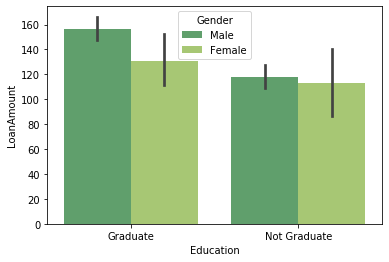

In [60]:
sns.barplot(y='LoanAmount',x='Education',data=df,hue='Gender',palette='summer')

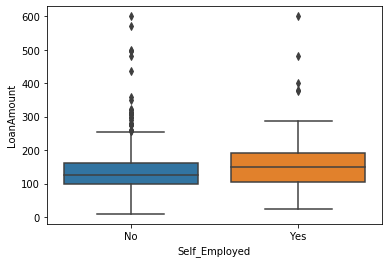

In [61]:
sns.boxplot(y='LoanAmount',x='Self_Employed',data=df)

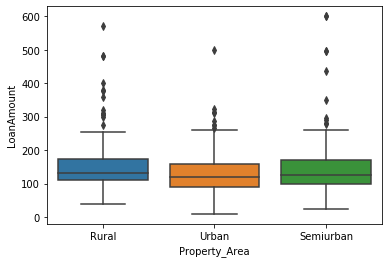

In [62]:
sns.boxplot(y='LoanAmount',x='Property_Area',data=df)

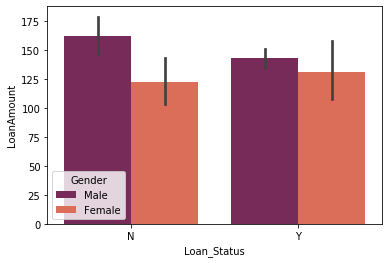

In [63]:
sns.barplot(y='LoanAmount',x='Loan_Status',hue='Gender',data=df,palette='rocket')

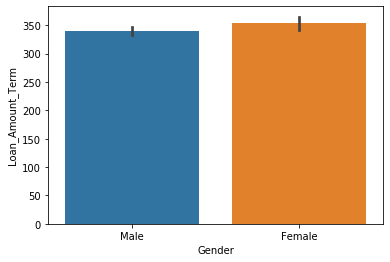

In [64]:
sns.barplot(x='Gender',y='Loan_Amount_Term',data=df)

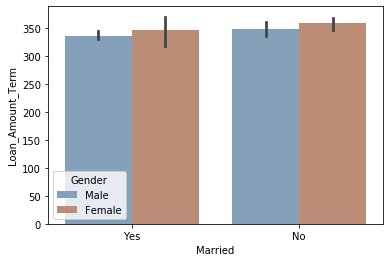

In [65]:
sns.barplot(x='Married',y='Loan_Amount_Term',hue='Gender',data=df,palette='twilight_shifted')

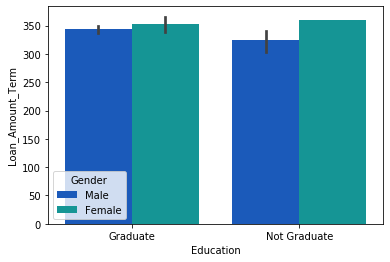

In [66]:
sns.barplot(x='Education',y='Loan_Amount_Term',hue='Gender',data=df,palette='winter')

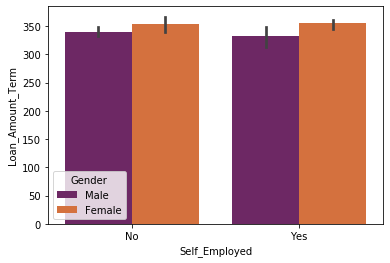

In [67]:
sns.barplot(x='Self_Employed',y='Loan_Amount_Term',hue='Gender',data=df,palette='inferno')

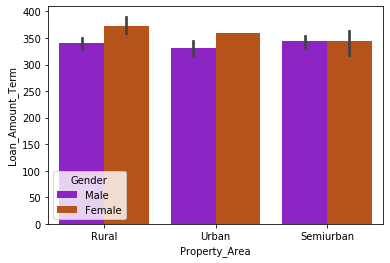

In [68]:
sns.barplot(x='Property_Area',y='Loan_Amount_Term',hue='Gender',data=df,palette='gnuplot')

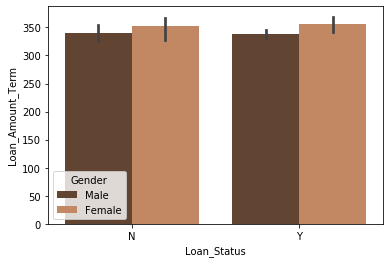

In [69]:
sns.barplot(x='Loan_Status',y='Loan_Amount_Term',hue='Gender',data=df,palette='copper')

In [70]:
#check correlation values
df_cor=df.corr()
df_cor

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History
ApplicantIncome,1.000000,-0.112588,0.495310,-0.010838,-0.056152
CoapplicantIncome,-0.112588,1.000000,0.190740,-0.005775,-0.008692
LoanAmount,0.495310,0.190740,1.000000,0.050867,-0.040773
Loan_Amount_Term,-0.010838,-0.005775,0.050867,1.000000,0.032937
Credit_History,-0.056152,-0.008692,-0.040773,0.032937,1.000000


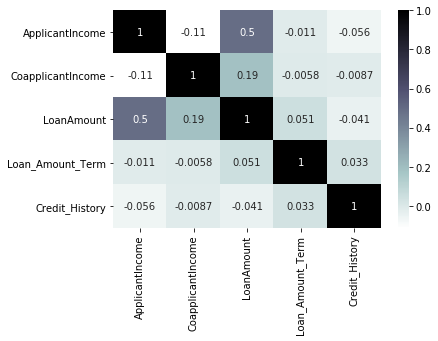

In [71]:
#lets see correlation in heatmap
sns.heatmap(df_cor,annot=True,cmap='bone_r')

The correlation between loan amount and coapplicant income shows postive correlation,whereas coapplicant income to applicant income shows negative correlation

In [72]:
#label encoing used
from sklearn import preprocessing
le=preprocessing.LabelEncoder()
le_count=0
for col in df.columns[1:]:
    if df[col].dtype=='object':
        if len(list(df[col].unique())) <=6:
            le.fit(df[col])
            df[col]=le.transform(df[col])
            le_count +=1
print('{}columns were label encoded.'.format(le_count))

6columns were label encoded.


In [73]:
df.dtypes

Gender                object
Married                int32
Dependents             int32
Education              int32
Self_Employed          int32
ApplicantIncome        int64
CoapplicantIncome    float64
LoanAmount           float64
Loan_Amount_Term     float64
Credit_History       float64
Property_Area          int32
Loan_Status            int32
dtype: object

In [74]:
label=le.fit_transform(df['Gender'])
le.classes_

array(['Female', 'Male'], dtype=object)

In [75]:
df.drop(columns=['Gender'])

,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
1,1,1,0,0,4583,1508.0,128.0,360.0,1.0,0,0
2,1,0,0,1,3000,0.0,66.0,360.0,1.0,2,1
3,1,0,1,0,2583,2358.0,120.0,360.0,1.0,2,1
4,0,0,0,0,6000,0.0,141.0,360.0,1.0,2,1
5,1,2,0,1,5417,4196.0,267.0,360.0,1.0,2,1
...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,2900,0.0,71.0,360.0,1.0,0,1
610,1,3,0,0,4106,0.0,40.0,180.0,1.0,0,1
611,1,1,0,0,8072,240.0,253.0,360.0,1.0,2,1
612,1,2,0,0,7583,0.0,187.0,360.0,1.0,2,1


In [76]:
df['Gender']=label
df

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
1,1,1,1,0,0,4583,1508.0,128.0,360.0,1.0,0,0
2,1,1,0,0,1,3000,0.0,66.0,360.0,1.0,2,1
3,1,1,0,1,0,2583,2358.0,120.0,360.0,1.0,2,1
4,1,0,0,0,0,6000,0.0,141.0,360.0,1.0,2,1
5,1,1,2,0,1,5417,4196.0,267.0,360.0,1.0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,0,2900,0.0,71.0,360.0,1.0,0,1
610,1,1,3,0,0,4106,0.0,40.0,180.0,1.0,0,1
611,1,1,1,0,0,8072,240.0,253.0,360.0,1.0,2,1
612,1,1,2,0,0,7583,0.0,187.0,360.0,1.0,2,1


for gender male-1,female-0
for married yes-1,no-0
for education gradute-0,not graduate-1
for self employed no-0,yes,1
for property are rural-0,urban-2,semi urban-1
for loan status no-0,yes-1

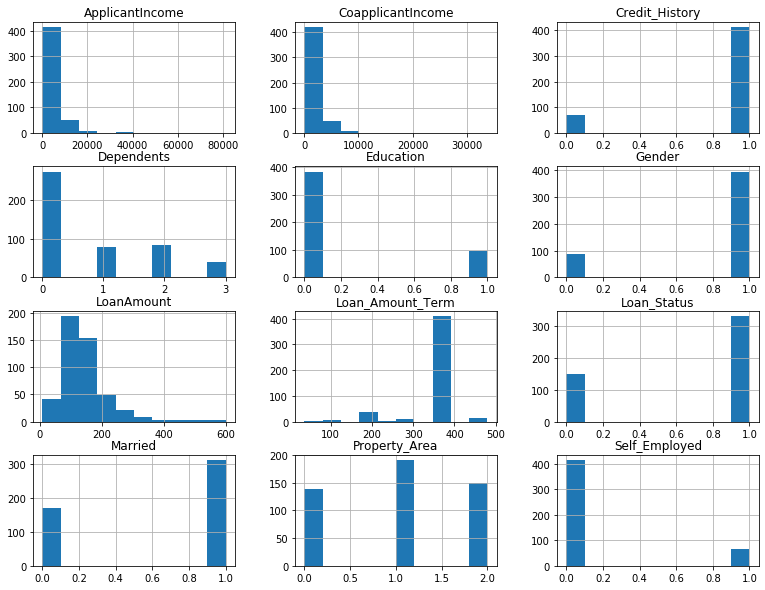

In [77]:
df.hist(figsize=(13,10))
plt.show()

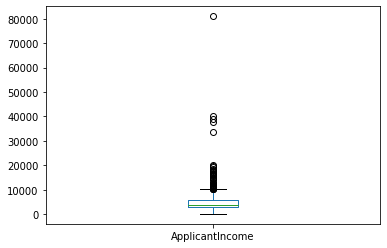

In [78]:
#lets check outliers
df['ApplicantIncome'].plot.box()

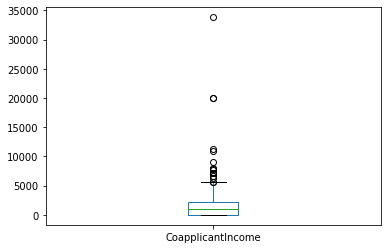

In [79]:
df['CoapplicantIncome'].plot.box()

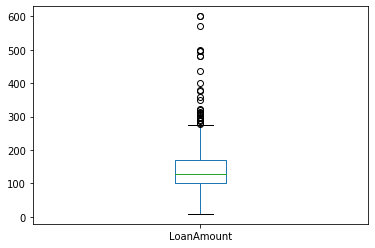

In [80]:
df['LoanAmount'].plot.box()

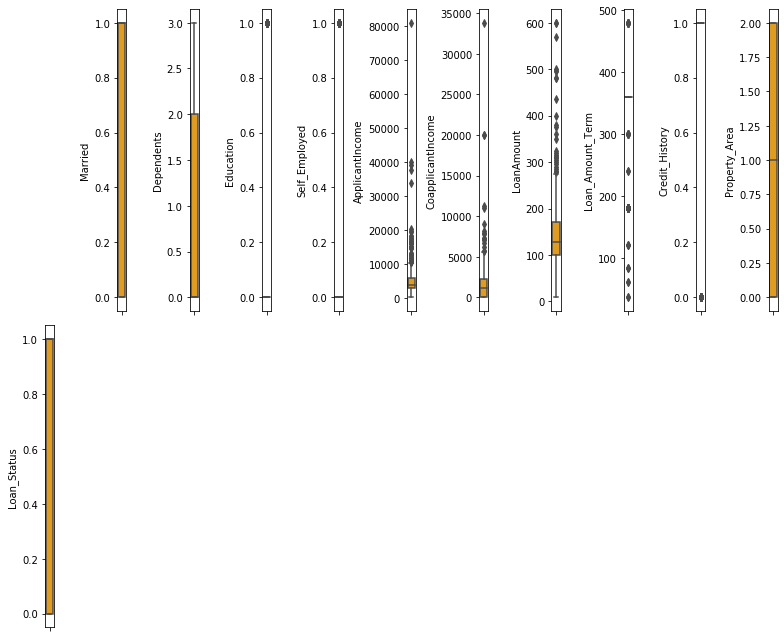

In [81]:
collist=df.columns.values
ncol=11
nrows=20
plt.figure(figsize=(ncol,8*ncol))
for i in range(1, len(collist)):
    plt.subplot(nrows,ncol,i+1)
    sns.boxplot(df[collist[i]],color='orange',orient='v')
    plt.tight_layout()

In [82]:
#skewness
df.skew()

Gender              -1.678471
Married             -0.621334
Dependents           0.942272
Education            1.488474
Self_Employed        2.111872
ApplicantIncome      6.917027
CoapplicantIncome    5.881622
LoanAmount           2.361437
Loan_Amount_Term    -2.333710
Credit_History      -2.013253
Property_Area       -0.039673
Loan_Status         -0.832681
dtype: float64

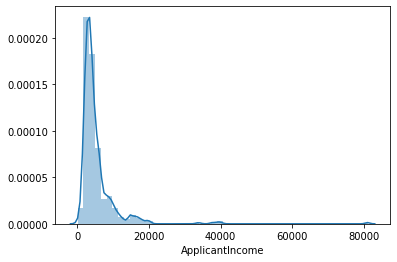

In [83]:
sns.distplot(df['ApplicantIncome'])

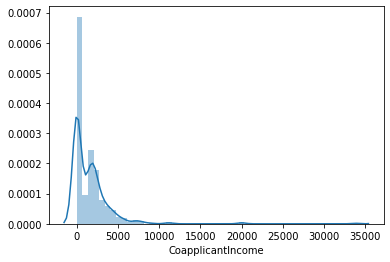

In [84]:
sns.distplot(df['CoapplicantIncome'])

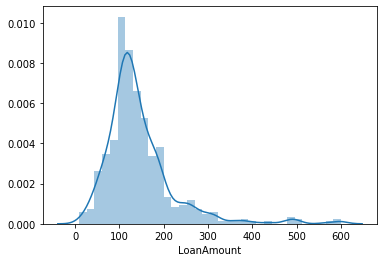

In [85]:
sns.distplot(df['LoanAmount'])

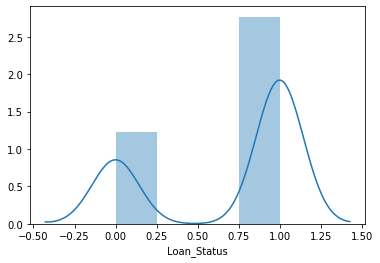

In [86]:
sns.distplot(df['Loan_Status'])

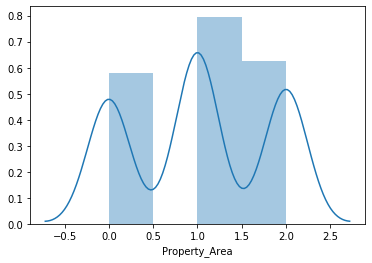

In [87]:
sns.distplot(df['Property_Area'])

In [88]:
#The skewness for ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term are dosent show normal distrbution

In [89]:
#using standard scaler
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
sc=scaler.fit_transform(df)
sc=pd.DataFrame(sc,columns=df.columns)

In [90]:
df.skew()

Gender              -1.678471
Married             -0.621334
Dependents           0.942272
Education            1.488474
Self_Employed        2.111872
ApplicantIncome      6.917027
CoapplicantIncome    5.881622
LoanAmount           2.361437
Loan_Amount_Term    -2.333710
Credit_History      -2.013253
Property_Area       -0.039673
Loan_Status         -0.832681
dtype: float64

In [91]:
df1=df.drop(columns=['Gender','Married','Loan_Amount_Term','Credit_History','Property_Area','Loan_Status'])

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


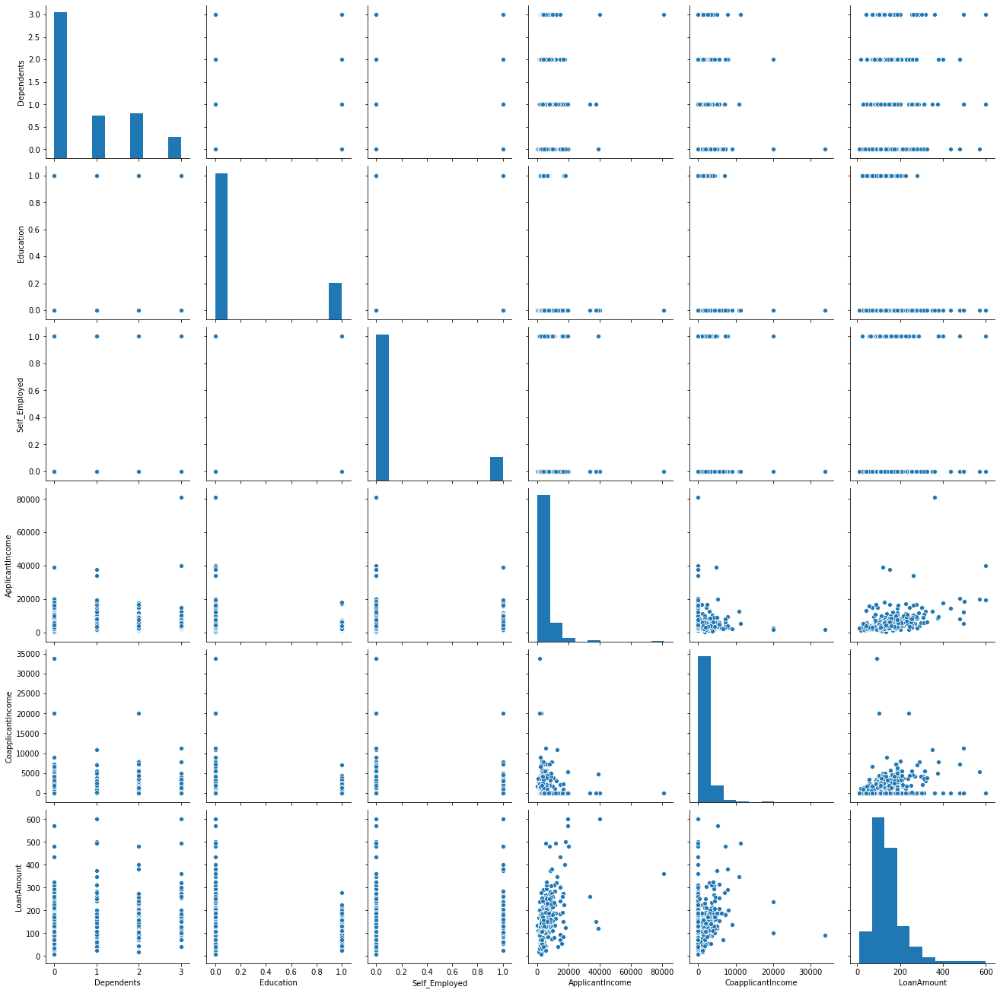

In [92]:
sns.pairplot(df1,size=3)
plt.show()

In [93]:
from scipy.stats import zscore
z=np.abs(zscore(df))
z

array([[0.46719815, 0.73716237, 0.21859918, ..., 0.41319694, 1.31886834,
        1.49774605],
       [0.46719815, 0.73716237, 0.76203265, ..., 0.41319694, 1.25977445,
        0.66766993],
       [0.46719815, 0.73716237, 0.76203265, ..., 0.41319694, 1.25977445,
        0.66766993],
       ...,
       [0.46719815, 0.73716237, 0.21859918, ..., 0.41319694, 1.25977445,
        0.66766993],
       [0.46719815, 0.73716237, 1.19923101, ..., 0.41319694, 1.25977445,
        0.66766993],
       [2.14041943, 1.35655324, 0.76203265, ..., 2.42015348, 0.02954695,
        1.49774605]])

In [94]:
Threshold=3
print(np.where(z>3))

(array([  8,  12,  54,  75,  98, 120, 120, 137, 137, 142, 144, 187, 205,
       220, 244, 286, 312, 319, 326, 347, 380, 386, 409, 410, 426, 438,
       450, 454, 457, 471], dtype=int64), array([6, 8, 8, 8, 8, 5, 7, 6, 7, 5, 5, 8, 8, 7, 7, 7, 6, 5, 6, 5, 7, 8,
       7, 7, 8, 7, 8, 6, 8, 7], dtype=int64))


In [95]:
z[8][6]

3.589688470140909

In [96]:
df_new=df[(z<3).all(axis=1)]
df_new

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
1,1,1,1,0,0,4583,1508.0,128.0,360.0,1.0,0,0
2,1,1,0,0,1,3000,0.0,66.0,360.0,1.0,2,1
3,1,1,0,1,0,2583,2358.0,120.0,360.0,1.0,2,1
4,1,0,0,0,0,6000,0.0,141.0,360.0,1.0,2,1
5,1,1,2,0,1,5417,4196.0,267.0,360.0,1.0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,0,2900,0.0,71.0,360.0,1.0,0,1
610,1,1,3,0,0,4106,0.0,40.0,180.0,1.0,0,1
611,1,1,1,0,0,8072,240.0,253.0,360.0,1.0,2,1
612,1,1,2,0,0,7583,0.0,187.0,360.0,1.0,2,1


In [97]:
print(df_new.shape,df.shape)

(452, 12) (480, 12)


There are 28 outliers are removed

In [98]:
df=df_new

In [99]:
df.shape

(452, 12)

In [100]:
#lets split the data
x=df.drop(columns=['Loan_Status'])
x.head()

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area
1,1,1,1,0,0,4583,1508.0,128.0,360.0,1.0,0
2,1,1,0,0,1,3000,0.0,66.0,360.0,1.0,2
3,1,1,0,1,0,2583,2358.0,120.0,360.0,1.0,2
4,1,0,0,0,0,6000,0.0,141.0,360.0,1.0,2
5,1,1,2,0,1,5417,4196.0,267.0,360.0,1.0,2


In [101]:
y=pd.DataFrame(df['Loan_Status'])
y.head()

,Loan_Status
1,0
2,1
3,1
4,1
5,1


In [102]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
x=sc.fit_transform(x)
x

array([[ 0.47076706,  0.74381759,  0.23987753, ...,  0.23288168,
         0.41716421, -1.30855611],
       [ 0.47076706,  0.74381759, -0.74580105, ...,  0.23288168,
         0.41716421,  1.25190866],
       [ 0.47076706,  0.74381759, -0.74580105, ...,  0.23288168,
         0.41716421,  1.25190866],
       ...,
       [ 0.47076706,  0.74381759,  0.23987753, ...,  0.23288168,
         0.41716421,  1.25190866],
       [ 0.47076706,  0.74381759,  1.22555611, ...,  0.23288168,
         0.41716421,  1.25190866],
       [-2.12419282, -1.34441564, -0.74580105, ...,  0.23288168,
        -2.3971376 , -0.02832373]])

In [103]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,roc_curve,auc
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB

In [104]:
from sklearn.model_selection import train_test_split,cross_val_score
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=9,test_size=0.3,stratify=y)

In [105]:
print(x_train.shape,x_test.shape)

(316, 11) (136, 11)


In [106]:
print(y_train.shape,y_test.shape)

(316, 1) (136, 1)


In [107]:
knn=KNeighborsClassifier()
dt=DecisionTreeClassifier(random_state=6)
sv=SVC()
lr=LogisticRegression()
gn=GaussianNB()

In [108]:
models = []
models.append(('KNneighborsClassifier',knn))
models.append(('DecisionTreeClassifier',dt))
models.append(('SVC',sv))
models.append(('LogisticRegression',lr))
models.append(('GaussianNB',gn))

*************************** KNneighborsClassifier ***************************


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  if __name__ == '__main__':
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expect



AccuracyScore= 0.8235294117647058


cross_val_score= 0.7942028985507246


roc_auc_score= 0.741976893453145


classification_report
               precision    recall  f1-score   support

           0       0.81      0.54      0.65        41
           1       0.83      0.95      0.88        95

    accuracy                           0.82       136
   macro avg       0.82      0.74      0.76       136
weighted avg       0.82      0.82      0.81       136



[[22 19]
 [ 5 90]]


AxesSubplot(0.125,0.808774;0.62x0.0712264)



*************************** DecisionTreeClassifier ***************************




C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:515: DataConversionWarning: A column-vector y

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=6, splitter='best')


AccuracyScore= 0.7573529411764706


cross_val_score= 0.7038164251207729


roc_auc_score= 0.7292682926829268


classification_report
               precision    recall  f1-score   support

           0       0.59      0.66      0.62        41
           1       0.84      0.80      0.82        95

    accuracy                           0.76       136
   macro avg       0.72      0.73      0.72       136
weighted avg       0.77      0.76      0.76       136



[[27 14]
 [19 76]]


AxesSubplot(0.125,0.808774;0.62x0.0712264)



*************************** SVC *************

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), 

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


AccuracyScore= 0.8529411764705882


cross_val_score= 0.8141062801932367


roc_auc_score= 0.7630295250320924


classification_report
               precision    recall  f1-score   support

           0       0.96      0.54      0.69        41
           1       0.83      0.99      0.90        95

    accuracy                           0.85       136
   macro avg       0.89      0.76      0.80       136
weighted avg       0.87      0.85      0.84       136



[[22 19]
 [ 1 94]]


AxesSubplot(0.125,0.808774;0.62x0.0712264)



*************************** LogisticRegression ***************************


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), 

AxesSubplot(0.125,0.808774;0.62x0.0712264)





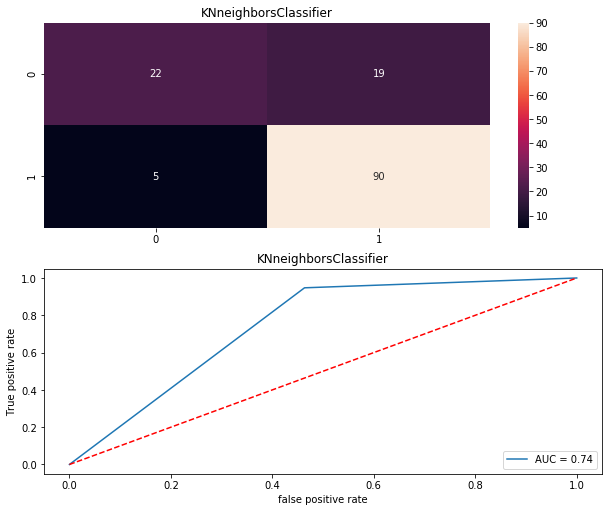

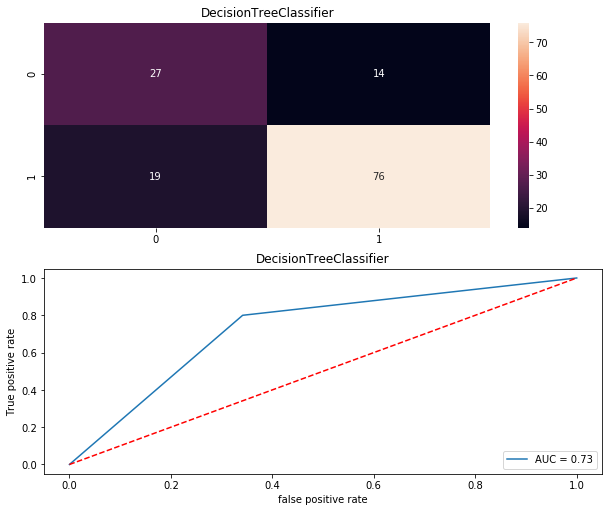

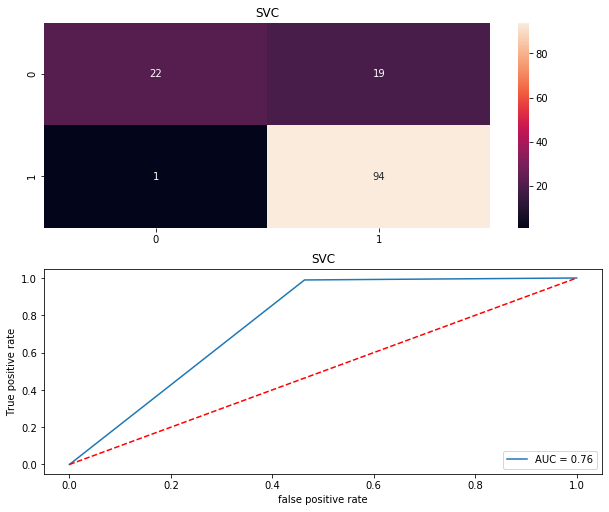

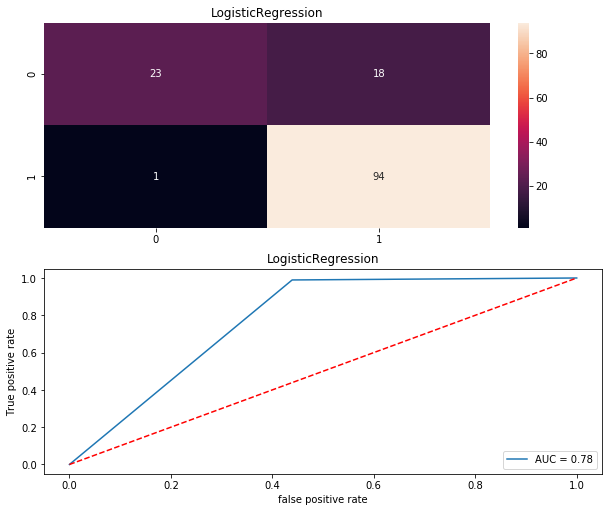

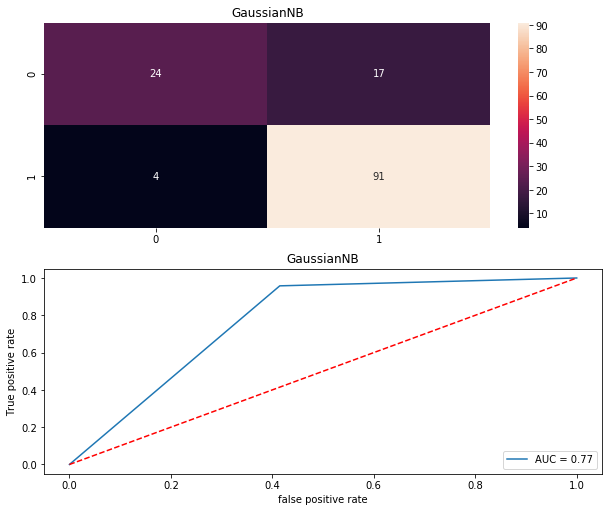

In [109]:
Model = []
score = []
cvs = []
rocscore=[]
for name,model in models:
    print('***************************',name,'***************************')
    print('\n')
    Model.append(name)
    model.fit(x_train,y_train)
    print(model)
    pre=model.predict(x_test)
    print('\n')
    AS=accuracy_score(y_test,pre)
    print('AccuracyScore=',AS)
    score.append(AS*100)
    print('\n')
    sc=cross_val_score(model,x,y,cv=10,scoring='accuracy').mean()
    print('cross_val_score=',sc)
    cvs.append(sc*100)
    print('\n')
    false_positive_rate,true_positive_rate,thresholds = roc_curve(y_test,pre)
    roc_auc=auc(false_positive_rate,true_positive_rate)
    print('roc_auc_score=',roc_auc)
    rocscore.append(roc_auc*100)
    print('\n')
    print('classification_report\n',classification_report(y_test,pre))
    print('\n')
    cm=confusion_matrix(y_test,pre)
    print(cm)
    print('\n')
    plt.figure(figsize=(10,40))
    plt.subplot(911)
    plt.title(name)
    print(sns.heatmap(cm,annot=True,cmap='rocket'))
    plt.subplot(912)
    plt.title(name)
    plt.plot(false_positive_rate,true_positive_rate,label='AUC = %0.2f'% roc_auc)
    plt.plot([0,1],[0,1],'r--')
    plt.legend(loc='lower right')
    plt.ylabel('True positive rate')
    plt.xlabel('false positive rate')
    print('\n\n')

In [110]:
result=pd.DataFrame({'Model':Model,'Accuracy_score':score,'Cross_val_score':cvs,'roc_auc_curve':rocscore})
result

,Model,Accuracy_score,Cross_val_score,roc_auc_curve
0,KNneighborsClassifier,82.352941,79.420290,74.197689
1,DecisionTreeClassifier,75.735294,70.381643,72.926829
2,SVC,85.294118,81.410628,76.302953
3,LogisticRegression,86.029412,81.859903,77.522465
4,GaussianNB,84.558824,80.971014,77.163030


I choose LogisticRegression as my final model because it perform very well on your dataset

Accuracy_score=86.029412
cross_val_score=81.859903
roc_auc_curve=77.163030

In [111]:
#prediction result
t=np.array([0,1,2,1,1,5000,2000,80.0,180.0,1.0,0])

In [112]:
t.shape

(11,)

In [113]:
t=t.reshape(1,-1)

In [114]:
t.shape

(1, 11)

In [115]:
lr.predict(t)

array([1])

1 is yes for loan status

In [116]:
#save model
from joblib import dump,load
dump(df,'Loan_fraud_detection.joblib')

['Loan_fraud_detection.joblib']